<a href="https://colab.research.google.com/github/Gustavoq14/Optimization-Algorithms/blob/main/Classic_optimization_algorithms.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1 Librerias

In [230]:
!pip install celluloid
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import math

from IPython.display import HTML
from celluloid import Camera
from mpl_toolkits.mplot3d import Axes3D

#2. Funciones de Prueba

## 2.1 Función De Jong's

$$f(x)=\displaystyle\sum_{i=1}^{n} x_{i}^2\hspace{2cm} $$

Tiene un minimo global en $f_*=0$ en $x=(0, 0,\ldots,0)$. Es una función unimodal convexa. En el dominio $-5.12\leq x\leq 5.12$. En 2D es

$$f(x,y) = x^2+y^2$$



In [231]:
def funcion_dejongs(x, y, a = 1, b = 1):
  return a*np.power(x, 2) + b*np.power(y, 2)

def grad_dejongs(x, y, a = 1, b = 1):
  df_dx = 2*a*x
  df_dy = 2*b*y
  return np.array([df_dx, df_dy])

def hess_dejongs(x, y, a = 1, b = 1):
  df2_dx2 = 2*a
  df2_dy2 = 2*b
  df2_dxdy = 0
  df2_dydx = 0
  return np.array([[df2_dx2, df2_dxdy], [df2_dydx, df2_dy2]])

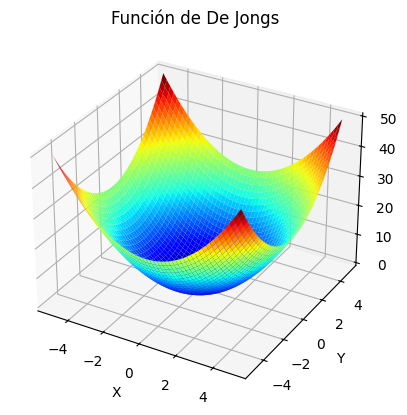

In [232]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)

X, Y = np.meshgrid(x, y)

Z = funcion_dejongs(X, Y)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X, Y, Z, cmap='jet')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Función de De Jongs')

plt.show()

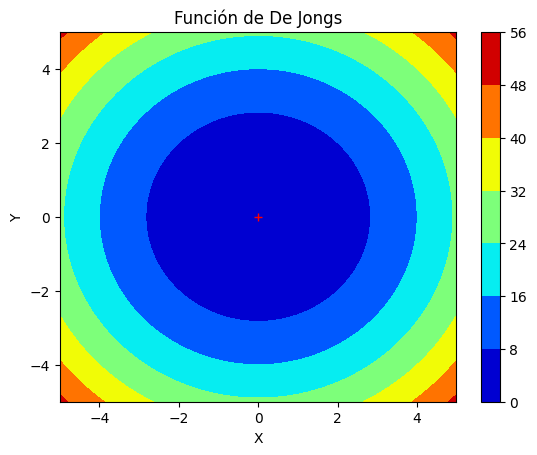

In [233]:
plt.figure()
plt.contourf(X, Y, Z, cmap = 'jet')
plt.plot(0,'+', color = 'red')
plt.colorbar()
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Función de De Jongs')
plt.show()

## 2.2 Función de Rosenbrock

$$f(x) = \displaystyle\sum_{i=1}^{n-1}[(x_i-1)^2+100(x_{i+1}-x_i^2)^2]$$

Tiene un minimo global en $f_{*}=0$ ocurre en $x_*=(1, 1,\ldots,1)$ en el dominio de $-5\leq x_i \leq 5$, donde $i = 1,2,\ldots,n$. En el caso de 2D, la función puede ser escrita como

$$f(x,y) = (x-a)^2+b(y-x^2)^2$$

la cual es referenciada a menudo como la función banana

In [234]:
def funcion_rosenbrock(x, y, a = 1, b = 100):
  return np.power(x-a, 2) + b*np.power(y-np.power(x, 2), 2)

def grad_rosenbrock(x, y, a = 1, b = 100):
  df_dx = 2*(x-a) - 4*b*(y-pow(x,2))*x
  df_dy = 2*b*(y-pow(x,2))
  return np.array([df_dx, df_dy])

def hess_rosenbrock(x, y, a = 1, b = 100):
  df2_dx2 = 12*b*pow(x,2)-4*b*y+2
  df2_dy2 = 2*b
  df2_dxdy = -4*b*x
  return np.array([[df2_dx2, df2_dxdy],[df2_dxdy, df2_dy2]])

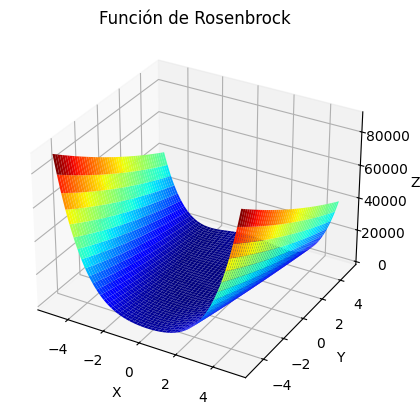

In [235]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)

X, Y = np.meshgrid(x, y)

Z = funcion_rosenbrock(X, Y)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X, Y, Z, cmap='jet')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Función de Rosenbrock')

plt.show()

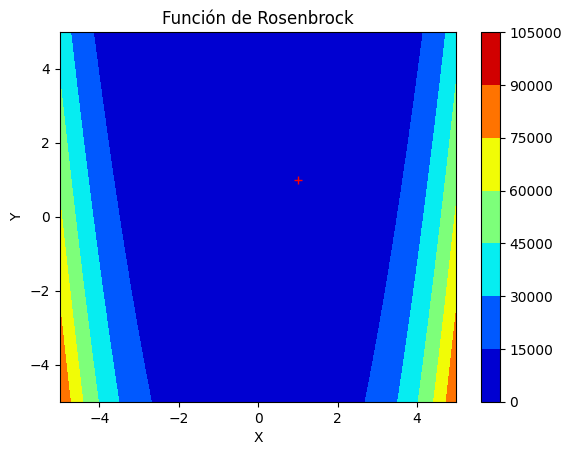

In [236]:
plt.figure()
plt.contourf(X, Y, Z, cmap='jet')
plt.plot(1, 1,'+', color = 'red')
plt.colorbar()
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Función de Rosenbrock')
plt.show()

## 2.3 Función de Ackely

$$f(x)= -a\exp\left(-b\sqrt{\frac{1}{d}\sum_{i=1}^{d} x_{i}^{2}}\right)-\exp\left(\frac{1}{d}\sum_{i=1}^{d}\cos(cx_{i})\right)+a+\exp(1)$$

Con un minimo global en el origen. Tipicamente a=20, b=0.2 y $c=2\pi$. En 2D

$$f(x,y) = -a\exp\left(-b\sqrt{\frac{1}{d}(x^{2}+ y^{2})}\right)-\exp\left(\frac{1}{d}(\cos(cx)+\cos(cy))\right)+a+\exp(1)$$

In [237]:
def funcion_ackley(x, y, a = 20, b = 0.2, c = 2*np.pi):
  d = 2
  return -a*np.exp(-b*np.sqrt((np.power(x,2)+np.power(y,2))/d)) - np.exp((np.cos(c*x)+np.cos(c*y))/d) + a + np.exp(1)

def grad_ackley(x, y, a = 20, b = 0.2, c = 2*math.pi):
  d = 2
  df_dx1 = (a*b*x / (d*math.sqrt((pow(x,2)+pow(y,2))/d)))*math.exp(-b*math.sqrt((pow(x,2)+pow(y,2))/d))
  df_dx2 = ((c*math.sin(c*x))*math.exp((math.cos(c*x)+math.cos(c*y))/d))/d
  df_dx = df_dx1 + df_dx2
  df_dy1 = (a*b*y / (d*math.sqrt((pow(x,2)+pow(y,2))/d)))*math.exp(-b*math.sqrt((pow(x,2)+pow(y,2))/d))
  df_dy2 = ((c*math.sin(c*y))*math.exp((math.cos(c*x)+math.cos(c*y))/d))/d
  df_dy = df_dy1 + df_dy2
  return np.array([df_dx, df_dy])

def hess_ackley(x, y, a = 20, b = 0.2, c = 2*math.pi):
  d = 2
  n1 = pow(b,2)*pow(x,2)*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n2 = b*pow(x,2)*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n3 = b*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  d1 = d*(pow(x,2)+pow(y,2))
  d2 = pow(d,2)*pow(((pow(x,2)+pow(y,2))/d), 3/2)
  d3 = d*math.sqrt(((pow(x,2)+pow(y,2))/d))
  n4 = pow(c,2)*pow(math.sin(c*x),2)*math.exp((math.cos(c*x)+math.cos(c*y))/d)
  n5 = pow(c,2)*math.cos(c*x)*math.exp((math.cos(c*x)+math.cos(c*y))/d)
  df2_dx2 = -a*(n1/d1 + n2/d2 - n3/d3)-n4/pow(d,2)+n5/d
  n6 = a*pow(b,2)*x*y*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n7 = a*b*x*y*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n8 = pow(c,2)*math.sin(c*x)*math.sin(c*y)*math.exp((math.cos(c*x)+math.cos(c*y))/d)
  df2_dxdy = -n6/d1-n7/d2-n8/pow(d,2)
  n9 = pow(b,2)*pow(y,2)*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n10 = b*pow(y,2)*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n11 = b*math.exp(-b*(math.sqrt((pow(x, 2)+pow(y,2))/d)))
  n12 = pow(c,2)*pow(math.sin(c*y),2)*math.exp((math.cos(c*x)+math.cos(c*y))/d)
  n13 = pow(c,2)*math.cos(c*y)*math.exp((math.cos(c*x)+math.cos(c*y))/d)
  df2_dy2 = -a*(n9/d1 + n10/d2 - n11/d3)-n12/pow(d,2)+n13/d
  return np.array([[df2_dx2, df2_dxdy],[df2_dxdy, df2_dy2]])

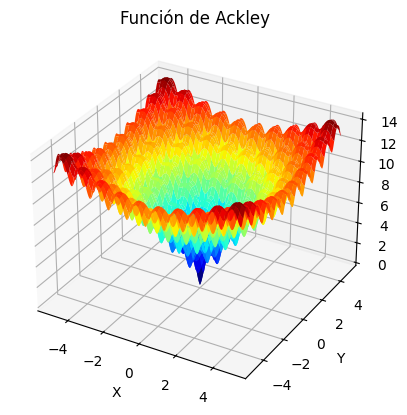

In [238]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)

X, Y = np.meshgrid(x, y)

Z = funcion_ackley(X, Y)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X, Y, Z, cmap='jet')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Función de Ackley')

plt.show()

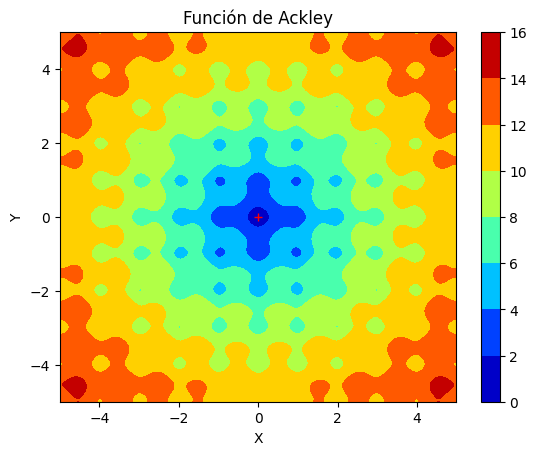

In [239]:
plt.figure()
plt.contourf(X, Y, Z, cmap = 'jet')
plt.plot(0,'+', color = 'red')
plt.colorbar()
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Función de Ackley')
plt.show()

## 2.4 Función Alpha

$$f(x, y) =\displaystyle\frac{7xy}{\exp(x^2+y^2)} $$.

Cuyo función tiene dos minimos globales en $\left(-\frac{1}{\sqrt{2}}, \frac{1}{\sqrt{2}}\right)$ y $\left(\frac{1}{\sqrt{2}}, -\frac{1}{\sqrt{2}}\right)$ y vale $-7/2e$

In [240]:
def funcion_alpha(x, y):
  return 7*x*y*np.exp(-np.power(x,2)-np.power(y,2))

def grad_alpha(x, y):
  df_dx = -7*y*(2*pow(x,2)-1)*math.exp(-pow(x,2)-pow(y,2))
  df_dy = -7*x*(2*pow(y,2)-1)*math.exp(-pow(x,2)-pow(y,2))
  return np.array([df_dx, df_dy])

def hess_alpha(x, y):
  df2_dx2 = 14*x*y*(2*pow(x,2)-3)*math.exp(-pow(x,2)-pow(y,2))
  df2_dxdy = 7*(2*pow(y,2)-1)*(2*pow(x,2)-1)*math.exp(-pow(x,2)-pow(y,2))
  df2_dy2 = 14*x*y*(2*pow(y,2)-3)*math.exp(-pow(x,2)-pow(y,2))
  return np.array([[df2_dx2, df2_dxdy], [df2_dxdy, df2_dy2]])

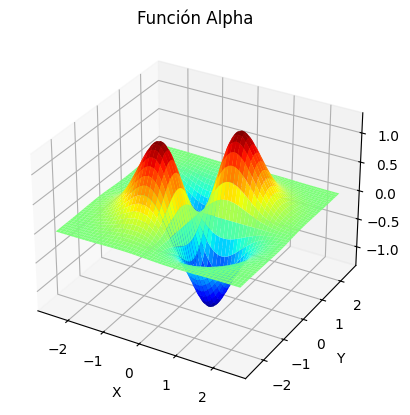

In [241]:
x = np.arange(-2.5, 2.5, 0.01)
y = np.arange(-2.5, 2.5, 0.01)

X, Y = np.meshgrid(x, y)

Z = funcion_alpha(X, Y)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X, Y, Z, cmap='jet')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Función Alpha')

plt.show()

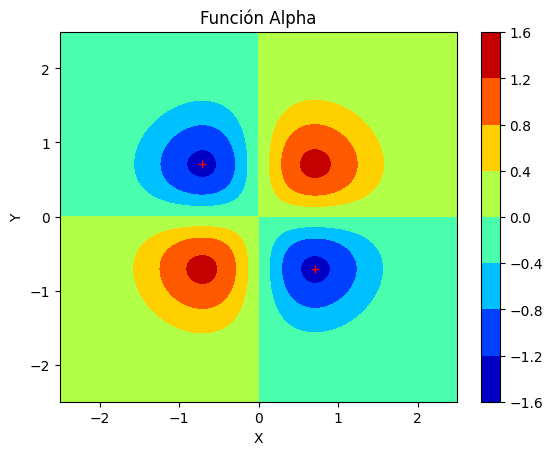

In [242]:
plt.figure()
plt.contourf(X, Y, Z, cmap = 'jet')
plt.plot(-1/np.sqrt(2), 1/np.sqrt(2),'+', color = 'red')
plt.plot(1/np.sqrt(2), -1/np.sqrt(2),'+', color = 'red')
plt.colorbar()
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Función Alpha')
plt.show()

## 3.5 Función de ThreeHumpCamel

$$f(x,y)=ax^2-bx^4+\frac{x^6}{c}+xy+y^2$$

Tiene un minimo global en $x=0$ y $y=0$ donde $f(x,y)=0$, minimos lo locales dependientes de los coefcientes $a = 2, b = 1.05, c = 6$



In [243]:
def funcion_THC(x, y, a = 2, b = 1.05, c = 6):
  return a*np.power(x,2)- b*np.power(x, 4) + np.power(x,6)/c + x*y + np.power(y, 2)

def grad_THC(x, y, a = 2, b = 1.05, c = 6):
  df_dx = 2*a*x-4*b*pow(x,3)+6*pow(x,5)/c + y
  df_dy = x+2*y
  return np.array([df_dx, df_dy])

def hess_THC(x, y, a = 2, b = 1.05, c = 6):
  df2_dx2 = -12*b*pow(x, 2)+30*pow(x,4)/c + 2*a
  df2_dxdy = 1
  df2_dy2 = 2
  return np.array([[df2_dx2, df2_dxdy],[df2_dxdy, df2_dy2]])

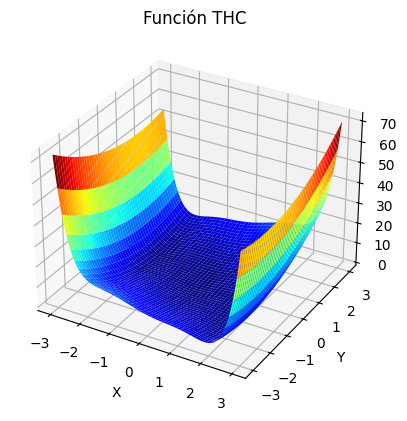

In [244]:
x = np.arange(-3, 3, 0.01)
y = np.arange(-3, 3, 0.01)

X, Y = np.meshgrid(x, y)

Z = funcion_THC(X, Y)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(X, Y, Z, cmap='jet')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Función THC')

plt.show()

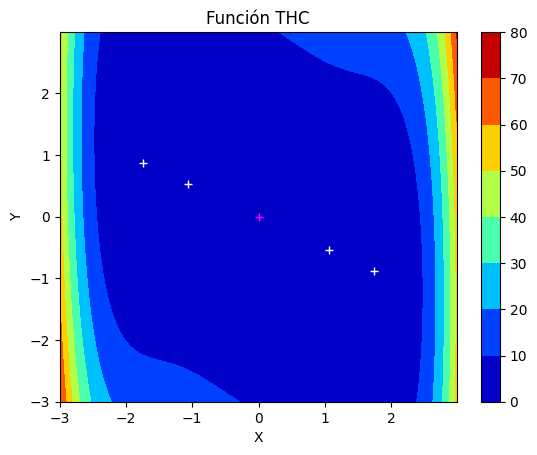

In [245]:
plt.figure()
plt.contourf(X, Y, Z, cmap = 'jet')
plt.plot(0, 0,'+', color = 'fuchsia')
plt.plot(1.071, -0.536,'+', color = 'w')
plt.plot(-1.071, 0.536,'+', color = 'w')
plt.plot(1.747, -0.874,'+', color = 'w')
plt.plot(-1.747, 0.874,'+', color = 'w')
plt.colorbar()
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Función THC')
plt.show()

# 3 Métodos de Optimización

## 3.1 Gradiente Descendiente

In [246]:
def gd(x, y, funcion, gradiente, itmax = 1000, eta = 0.1, tol= 1e-2):
  theta = np.array([x, y])
  puntos = [theta.copy()]
  f = [funcion(x, y)]
  i = 0
  dif = 1
  while i < itmax and dif > tol:
    grad = gradiente(theta[0], theta[1])
    theta -= eta*grad/np.linalg.norm(grad)
    i +=1
    f.append(funcion(theta[0], theta[1]))
    puntos.append(theta.copy())
    dif = abs(f[i]-f[i-1])
  return theta, i, puntos

## 3.2 Newton-Raphson

In [247]:
def nr(x, y, funcion, gradiente, hessiana, itmax = 1000, tol = 1e-2):
  theta = np.array([x, y])
  puntos = [theta.copy()]
  f = [funcion(x, y)]
  i = 0
  dif = 1
  while i < itmax and dif > tol:
    grad = gradiente(theta[0], theta[1])
    H = hessiana(theta[0], theta[1])
    #H_inv = np.linalg.inv(H)
    #theta -= H_inv @ grad
    theta -= np.linalg.solve(H, grad)
    i += 1
    f.append(funcion(theta[0], theta[1]))
    puntos.append(theta.copy())
    dif = abs(f[i]-f[i-1])
    #dif = np.linalg.norm(grad) #es más común y robusto que la diferencia en los valores de la función objetivo.
  return theta, i, puntos

## 3.3 Método de Levenberg-Marquardt

In [248]:
'''
def lm(x, y, funcion, gradiente, hessiana, itmax = 1000, tol = 1e-2, l = 1.0):
  theta = np.array([x, y])
  puntos = [theta.copy()]
  f = [funcion(x, y)]
  i = 0
  k = 0
  dif = 1
  while i < itmax and dif > tol:
    grad = gradiente(x, y)
    H = hessiana(x, y)
    I = l*np.identity(2)
    #M = H + I
    #M_inv = np.linalg.inv(H)
    theta_nue = theta - np.linalg.solve(H + I, grad)
    #theta_nue = theta - M_inv @ grad
    i += 1
    f_nue = funcion(theta_nue[0], theta_nue[1])
    if f_nue < f[-1]:
      theta = theta_nue
      puntos.append(theta.copy())
      f.append(f_nue)
      k += 1
      l *= 0.1
    else:
      l *= 10.0
    if len(f) > 1:
      dif = abs(f[k] - f[k-1])
    l = min(max(l, 1e-7), 1e7)
  return theta, i, puntos
'''

def lm(x, y, funcion, gradiente, hessiana, itmax=1000, tol=1e-4, l=1.0):
    theta = np.array([x, y], dtype=float)
    puntos = [theta.copy()]
    f = [funcion(*theta)]

    for i in range(itmax):
        grad = gradiente(*theta)
        H = hessiana(*theta)
        I = np.eye(2)

        # Paso de Levenberg-Marquardt
        delta = np.linalg.solve(H + l*I, grad)
        theta_nue = theta - delta
        f_nue = funcion(*theta_nue)

        # Evaluar mejora
        if f_nue < f[-1]:
            theta = theta_nue
            f.append(f_nue)
            puntos.append(theta.copy())
            l *= 0.5
        else:
            l *= 2.0

        # Condición de parada por gradiente
        if np.linalg.norm(grad) < tol:
            break
        l = min(max(l, 1e-6), 1e4)
    return theta, i+1, np.array(puntos)

## 3.4 Monte Carlo-Aceptación y Rechazo

In [249]:
def mc_ar(x_l, y_l, funcion, itmax = 1000):
  k = 0
  x = -4
  y = 4.5
  count = [0]
  f = [funcion(x, y)]
  puntos = [np.array([x, y])]
  for i in range(itmax):
    x = np.random.uniform(x_l[0], x_l[1])
    y = np.random.uniform(y_l[0], y_l[1])
    m = min(f)
    f.append(funcion(x, y))
    k += 1
    if f[k] < m:
      puntos.append(np.array([x, y]))
      count.append(i)
  return puntos, count, f

## 3.5 Simulated Annealing

In [250]:
def sa(x_l, y_l, funcion, t0=500, alpha=0.99, itmax=1000):
    """
    Implementa el método de Simulated Annealing para minimizar una función de dos variables.

    Args:
        funcion: Función objetivo a minimizar.
        x_l: Límite inferior y superior para la variable x (lista o tupla).
        y_l: Límite inferior y superior para la variable y (lista o tupla).
        t0: Temperatura inicial.
        alpha: Factor de enfriamiento (0 < alpha < 1).
        itmax: Número máximo de iteraciones.

    Returns:
        puntos: Lista de puntos aceptados durante la optimización.
        f: Lista de valores de la función evaluada en cada iteración.
    """
    # Inicializar variables
    #x = np.random.uniform(x_l[0], x_l[1])
    #y = np.random.uniform(y_l[0], y_l[1])
    x = -4
    y = 4.5
    t = t0
    count = [0]
    f_current = funcion(x, y)
    puntos = [np.array([x, y])]
    f = [f_current]
    T = [t]
    for i in range(itmax):
        # Generar un nuevo candidato en el vecindario
        x_new = np.random.uniform(x_l[0], x_l[1])
        y_new = np.random.uniform(y_l[0], y_l[1])
        f_new = funcion(x_new, y_new)

        # Criterio de aceptación
        delta_f = f_new - f_current
        if delta_f < 0 or np.random.rand() < np.exp(-delta_f / t):
            # Aceptar el nuevo punto
            x, y = x_new, y_new
            f_current = f_new
            puntos.append(np.array([x, y]))
            f.append(f_current)
            count.append(i)
            T.append(t)

        # Enfriamiento
        t *= alpha
    return puntos, count, f, T

## 3.6 Self Cooling Simulated Annealing

In [251]:
def scsa(x_l, y_l, funcion, imax=1000, t0=500, k_c=None):
    """
    Self-Cooling Simulated Annealing para funciones f(x, y).

    Args:
        funcion : callable
            Función objetivo f(x, y) a minimizar.
        x_l, y_l : tuplas (xmin, xmax)
            Límites de búsqueda para x e y.
        imax : int
            Número total de iteraciones.
        t0 : float
            Temperatura inicial.
        k_c : float o None
            Parámetro de autoenfriamiento (si None, se calcula como 5/imax).

    Returns:
        puntos : lista de np.array([x, y]) con los puntos aceptados
        count  : lista con los índices de iteración de cada punto aceptado
        f      : lista con los valores de la función en cada punto aceptado
        T      : lista con la temperatura en cada paso
    """
    if k_c is None:
        k_c = 0.05

    # Inicialización aleatoria dentro de los límites
    #x = np.random.uniform(x_l[0], x_l[1])
    #y = np.random.uniform(y_l[0], y_l[1])
    x = -4
    y = 4.5
    f_actual = funcion(x, y)

    f_min_global = f_actual
    T_ext = abs(f_actual) + 1e-9
    t = max(t0, T_ext * 1.5)

    puntos = [np.array([x, y])]
    f = [f_actual]
    count = [0]
    T = [t]

    for i in range(imax):
        # Generar un candidato cercano
        x_new = np.random.normal(x, 0.1 * (x_l[1] - x_l[0]))
        y_new = np.random.normal(y, 0.1 * (y_l[1] - y_l[0]))
        f_new = funcion(x_new, y_new)

        # Criterio de aceptación tipo Boltzmann
        delta_f = f_new - f_actual
        if delta_f < 0 or np.random.rand() < np.exp(-delta_f / t):
            x, y = x_new, y_new
            f_actual = f_new
            #puntos.append(np.array([x, y]))
            f.append(f_actual)
            #count.append(i)
            #T.append(t)

            # Actualizar mínimo global y temperatura base
            if f_actual < f_min_global:
                f_min_global = f_actual
                T_ext = abs(f_min_global) + 1e-9
                puntos.append(np.array([x, y]))
                f.append(f_actual)
                T.append(t)
                count.append(i)

        # Enfriamiento autoajustado (self-cooling)
        t = t - k_c * (t - T_ext)

    return puntos, count, f, T

# 4 Testeando los Métodos

## 4.1 Gradiente Descendiente

### 4.1.1 Función Dejongs

In [252]:
x = -4.0 #x = random.uniform(-5, 5)
y = 4.5 #y = random.uniform(-5, 5)
theta, i, puntos = gd(x, y, funcion_dejongs, grad_dejongs)
i

61

In [253]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_dejongs(X, Y)

fig = plt.figure()
plt.title('Función Dejongs')
plt.suptitle('Gradiente Descendiente', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0, '+', color = 'red')
  plt.text(3, 3, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [254]:
#animation.save('GD_Dejongs.gif', writer='pillow')

### 4.1.2 Función Rosenbrock

In [255]:
x = -1.6   #x = random.uniform(-5, 5)
y = 2.5    #y = random.uniform(-5, 5)
theta, i, puntos = gd(x, y, funcion_rosenbrock, grad_rosenbrock, tol=1e-3)
i

1000

In [256]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_rosenbrock(X, Y)

fig = plt.figure()
plt.title('Función Rosenbrock')
plt.suptitle('Gradiente Descendiente', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 10):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(1, 1, '+', color = 'red')
  plt.text(3, 3, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [257]:
#animation.save('GD_Rosenbrock.gif', writer='pillow')

###4.1.3 Función de Ackley

In [258]:
x = -4.0  #x = random.uniform(-5, 5)
y = 4.5   #y = random.uniform(-5, 5)
theta, i, puntos = gd(x, y, funcion_ackley, grad_ackley)
i

1000

In [259]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_ackley(X, Y)

fig = plt.figure()
plt.title('Función de Ackley')
plt.suptitle('Gradiente Descendiente', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 10):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0,'+', color = 'red')
  plt.text(3, 3, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [260]:
#animation.save('GD_Ackley.gif', writer='pillow')

### 4.1.4 Función Alpha

In [261]:
x = -1.5 #random.uniform(-2.5, 2.5)
y = 2.5 #random.uniform(-2.5, 2.5)
theta, i, puntos = gd(x, y, funcion_alpha, grad_alpha, eta = 0.02, tol=1e-4)
i

1000

In [262]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_alpha(X, Y)

fig = plt.figure()
plt.title('Función Alpha')
plt.suptitle('Gradiente Descendiente', fontweight ="bold")
camera = Camera(fig)

for i in range(0, 111, 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(-1/np.sqrt(2), 1/np.sqrt(2),'+', color = 'red')
  plt.plot(1/np.sqrt(2), -1/np.sqrt(2),'+', color = 'red')
  plt.text(1.5, 1.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [263]:
#animation.save('GD_Alpha.gif', writer='pillow')

### 4.1.5 Función THC

In [264]:
x = -2.5 #random.uniform(-2.5, 2.5)
y = 1.5 #random.uniform(-2.5, 2.5)
theta, i, puntos = gd(x, y, funcion_THC, grad_THC, eta = 0.02, tol=1e-4)
len(puntos)

66

In [265]:
x = np.arange(-3, 3, 0.01)
y = np.arange(-3, 3, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_THC(X, Y)

fig = plt.figure()
plt.title('Función THC')
plt.suptitle('Gradiente Descendiente', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 10):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0,'+', color = 'fuchsia')
  plt.plot(1.071, -0.536,'+', color = 'w')
  plt.plot(-1.071, 0.536,'+', color = 'w')
  plt.plot(1.747, -0.874,'+', color = 'w')
  plt.plot(-1.747, 0.874,'+', color = 'w')
  plt.text(1.5, 1.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

## 4.2 Newton-Rapshon

### 4.2.1 Funcion de Dejongs

In [266]:
x = -4.0  #x = random.uniform(-5, 5)
y = 4.5   #y = random.uniform(-5, 5)
theta, i, puntos = nr(x, y, funcion_dejongs, grad_dejongs, hess_dejongs)
i

2

In [267]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_dejongs(X, Y)

fig = plt.figure()
plt.title('Función Dejongs')
plt.suptitle('Newton-Rapshon', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [268]:
#animation.save('NR_Dejongs.gif', writer='pillow', fps=1)

### 4.2.2 Funcion de Rosenbrock

In [269]:
x = -1.6  #x = random.uniform(-5, 5)
y = 2.5   #y = random.uniform(-5, 5)
theta, i, puntos = nr(x, y, funcion_rosenbrock, grad_rosenbrock, hess_rosenbrock)
i

10

In [270]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_rosenbrock(X, Y)

fig = plt.figure()
plt.title('Función Rosenbrock')
plt.suptitle('Newton-Rapshon', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(1, 1, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [271]:
#animation.save('NR_Rosenbrock.gif', writer='pillow', fps=1)

### 4.2.3 Función Ackley

In [272]:
x = -4.0  #x = random.uniform(-5, 5)
y = 4.5   #y = random.uniform(-5, 5)
theta, i, puntos = nr(x, y, funcion_ackley, grad_ackley, hess_ackley)
i

1

In [273]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_ackley(X, Y)

fig = plt.figure()
plt.title('Función Ackley')
plt.suptitle('Newton-Rapshon', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [274]:
#animation.save('NR_Ackley.gif', writer='pillow', fps=1)

### 4.2.4 Función Alpha

In [275]:
x = -1.5  #random.uniform(-2.5, 2.5)
y = 2.5   #random.uniform(-2.5, 2.5)
theta, i, puntos = nr(x, y, funcion_alpha, grad_alpha, hess_alpha, tol = 1e-4)
i

5

In [276]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_alpha(X, Y)

fig = plt.figure()
plt.title('Función Alpha')
plt.suptitle('Newton-Rapshon', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(-1/np.sqrt(2), 1/np.sqrt(2),'+', color = 'red')
  plt.plot(1/np.sqrt(2), -1/np.sqrt(2),'+', color = 'red')
  plt.text(1.5, 1.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [277]:
#animation.save('NR_Alpha.gif', writer='pillow', fps=1)

### 4.2.5 Función THC

In [278]:
x = -2.5 #random.uniform(-2.5, 2.5)
y = 1.5 #random.uniform(-2.5, 2.5)
theta, i, puntos = nr(x, y, funcion_THC, grad_THC, hess_THC, tol = 1e-3)
len(puntos)

6

In [279]:
x = np.arange(-3, 3, 0.01)
y = np.arange(-3, 3, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_THC(X, Y)

fig = plt.figure()
plt.title('Función THC')
plt.suptitle('Newton-Rapshon', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0,'+', color = 'fuchsia')
  plt.plot(1.071, -0.536,'+', color = 'w')
  plt.plot(-1.071, 0.536,'+', color = 'w')
  plt.plot(1.747, -0.874,'+', color = 'w')
  plt.plot(-1.747, 0.874,'+', color = 'w')
  plt.text(1.5, 1.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

## 4.3 Levenberg-Marquardt

### 4.3.1 Función Dejongs

In [280]:
x = -4.0  #x = random.uniform(-5, 5)
y = 4.5   #y = random.uniform(-5, 5)
theta, i, puntos = lm(x, y, funcion_dejongs, grad_dejongs, hess_dejongs)
len(puntos)

8

In [281]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_dejongs(X, Y)

fig = plt.figure()
plt.title('Función Dejongs')
plt.suptitle('Levenberg-Marquardt', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [282]:
#animation.save('LM_Dejongs.gif', writer='pillow', fps=1)

### 4.3.2 Funcion de Rosenbrock

In [283]:
x = -1.6
y = 2.5
theta, i, puntos = lm(x, y, funcion_rosenbrock, grad_rosenbrock, hess_rosenbrock)
len(puntos)

23

In [284]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_rosenbrock(X, Y)

fig = plt.figure()
plt.title('Función Rosenbrock')
plt.suptitle('Levenberg-Marquardt', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(1, 1, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [285]:
#animation.save('LM_Rosenbrock.gif', writer='pillow')

### 4.3.3 Función Ackley

In [286]:
x = -4  #x = random.uniform(-5, 5)
y = 4.5   #y = random.uniform(-5, 5)
theta, i, puntos = lm(x, y, funcion_ackley, grad_ackley, hess_ackley, l=1e2)
i

8

In [287]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_ackley(X, Y)

fig = plt.figure()
plt.title('Función Ackley')
plt.suptitle('Levenberg-Marquardt', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

### 4.3.4 Función Alpha

In [288]:
x = -1.5  #random.uniform(-2.5, 2.5)
y = 2.5   #random.uniform(-2.5, 2.5)
theta, i, puntos = lm(x, y, funcion_ackley, grad_ackley, hess_ackley, l = 1e3)
len(puntos)

17

In [289]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_alpha(X, Y)

fig = plt.figure()
plt.title('Función Alpha')
plt.suptitle('Levenberg-Marquardt', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(-1/np.sqrt(2), 1/np.sqrt(2),'+', color = 'red')
  plt.plot(1/np.sqrt(2), -1/np.sqrt(2),'+', color = 'red')
  plt.text(1.5, 1.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [290]:
#animation.save('LM_Alpha.gif', writer='pillow')

### 4.3.4 Función THC

In [291]:
x = -2.5 #random.uniform(-2.5, 2.5)
y = 1.5 #random.uniform(-2.5, 2.5)
theta, i, puntos = nr(x, y, funcion_THC, grad_THC, hess_THC)
len(puntos)

6

In [292]:
x = np.arange(-3, 3, 0.01)
y = np.arange(-3, 3, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_THC(X, Y)

fig = plt.figure()
plt.title('Función THC')
plt.suptitle('Levenberg-Marquardt', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0,'+', color = 'fuchsia')
  plt.plot(1.071, -0.536,'+', color = 'w')
  plt.plot(-1.071, 0.536,'+', color = 'w')
  plt.plot(1.747, -0.874,'+', color = 'w')
  plt.plot(-1.747, 0.874,'+', color = 'w')
  plt.text(1.5, 1.5, f' i = {i:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

## 4.4 Monte Carlo-Aceptación y Rechazo

### 4.4.1 Funcion de Ackley

In [293]:
x = (-5, 5)
y = (-5, 5)
puntos, count, f = mc_ar(x, y, funcion_ackley)

In [294]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_ackley(X, Y)

fig = plt.figure()
plt.title('Función Ackley')
plt.suptitle('Monte Carlo', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  plt.contourf(X, Y, Z, cmap='jet')
  plt.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  plt.plot(0, 0, '+', color = 'red')
  plt.text(3.5, 3.5, f' i = {count[i]:}', color='white', fontsize=10, weight='bold')
  camera.snap()

#plt.colorbar()
plt.xlabel('x')
plt.ylabel('y')
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [295]:
#animation.save('MC_Ackley.gif', writer='pillow', fps = 1)

## 4.5 Simulated annealing

### 4.5.1 Funcion de Ackley

In [296]:
x = (-5, 5)
y = (-5, 5)
puntos, count, f, T = sa(x, y, funcion_ackley, alpha = 0.98)
len(puntos)

256

In [297]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_ackley(X, Y)

#fig = plt.figure()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
plt.suptitle('Simulated Annealing', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  ax1.contourf(X, Y, Z, cmap='jet')
  ax1.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  ax1.plot(0, 0, '+', color = 'red')
  ax1.text(3.5, 3.5, f' i = {count[i]:}', color='white', fontsize=10, weight='bold')

  ax2.plot(count[:i+1], T[:i+1], color = 'red')
  camera.snap()

#ax1.set_colorbar()
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_title('Función Ackley')

ax2.set_xlabel('Iteración')
ax2.set_ylabel('Temperatura')
ax2.set_title("Temperatura vs Iteración")
ax2.grid()
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [298]:

#animation.save('SA_Ackley.gif', writer='pillow', fps = 1)

## 4.6 Self-Cooling Simulated Annealing

### 4.6.1 Funcion Ackley

In [299]:
x = (-5, 5)
y = (-5, 5)
puntos, count, f, T = scsa(x, y, funcion_ackley)
print(len(puntos), count[-1])

6 73


In [300]:
x = np.arange(-5, 5, 0.01)
y = np.arange(-5, 5, 0.01)
X, Y = np.meshgrid(x, y)
Z = funcion_ackley(X, Y)

#fig = plt.figure()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
plt.suptitle('Self-Cooling Simulated Annealing', fontweight ="bold")
camera = Camera(fig)

for i in range(0, len(puntos), 1):
  ax1.contourf(X, Y, Z, cmap='jet')
  ax1.plot(puntos[i][0], puntos[i][1], 'o' ,color = 'white')
  ax1.plot(0, 0, '+', color = 'red')
  ax1.text(3.5, 3.5, f' i = {count[i]:}', color='white', fontsize=10, weight='bold')

  ax2.plot(count[:i+1], T[:i+1], color = 'red')
  camera.snap()

#ax1.set_colorbar()
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_title('Función Ackley')

ax2.set_xlabel('Iteración')
ax2.set_ylabel('Temperatura')
ax2.set_title("Temperatura vs Iteración")
ax2.grid()
animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

In [301]:
#animation.save('SCSA_Ackley.gif', writer='pillow', fps = 1)